# Task 2

###By: Alejandro Thompson Oporto
---

## Predictive modeling of customer bookings

This Jupyter notebook includes some code to get you started with this predictive modeling task. We will use various packages for data manipulation, feature engineering and machine learning.

### Exploratory data analysis

First, we must explore the data in order to better understand what we have and the statistical properties of the dataset.

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import OneHotEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, roc_curve, auc
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_recall_curve
from sklearn.model_selection import cross_val_score
from sklearn.tree import export_graphviz
import graphviz
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns
import plotly.express as px

In [ ]:
df = pd.read_csv("/content/customer_booking.csv", encoding="ISO-8859-1")
df.head()

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
0,2,Internet,RoundTrip,262,19,7,Sat,AKLDEL,New Zealand,1,0,0,5.52,0
1,1,Internet,RoundTrip,112,20,3,Sat,AKLDEL,New Zealand,0,0,0,5.52,0
2,2,Internet,RoundTrip,243,22,17,Wed,AKLDEL,India,1,1,0,5.52,0
3,1,Internet,RoundTrip,96,31,4,Sat,AKLDEL,New Zealand,0,0,1,5.52,0
4,2,Internet,RoundTrip,68,22,15,Wed,AKLDEL,India,1,0,1,5.52,0


The `.head()` method allows us to view the first 5 rows in the dataset, this is useful for visual inspection of our columns

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   num_passengers         50000 non-null  int64  
 1   sales_channel          50000 non-null  object 
 2   trip_type              50000 non-null  object 
 3   purchase_lead          50000 non-null  int64  
 4   length_of_stay         50000 non-null  int64  
 5   flight_hour            50000 non-null  int64  
 6   flight_day             50000 non-null  object 
 7   route                  50000 non-null  object 
 8   booking_origin         50000 non-null  object 
 9   wants_extra_baggage    50000 non-null  int64  
 10  wants_preferred_seat   50000 non-null  int64  
 11  wants_in_flight_meals  50000 non-null  int64  
 12  flight_duration        50000 non-null  float64
 13  booking_complete       50000 non-null  int64  
dtypes: float64(1), int64(8), object(5)
memory usage: 5.3+ 

In [ ]:
df = df.dropna(axis=1)
df

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
0,2,Internet,RoundTrip,262,19,7,Sat,AKLDEL,New Zealand,1,0,0,5.52,0
1,1,Internet,RoundTrip,112,20,3,Sat,AKLDEL,New Zealand,0,0,0,5.52,0
2,2,Internet,RoundTrip,243,22,17,Wed,AKLDEL,India,1,1,0,5.52,0
3,1,Internet,RoundTrip,96,31,4,Sat,AKLDEL,New Zealand,0,0,1,5.52,0
4,2,Internet,RoundTrip,68,22,15,Wed,AKLDEL,India,1,0,1,5.52,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,2,Internet,RoundTrip,27,6,9,Sat,PERPNH,Australia,1,0,1,5.62,0
49996,1,Internet,RoundTrip,111,6,4,Sun,PERPNH,Australia,0,0,0,5.62,0
49997,1,Internet,RoundTrip,24,6,22,Sat,PERPNH,Australia,0,0,1,5.62,0
49998,1,Internet,RoundTrip,15,6,11,Mon,PERPNH,Australia,1,0,1,5.62,0


In [ ]:
df["sales_channel"].value_counts()

Internet    44382
Mobile       5618
Name: sales_channel, dtype: int64

In [ ]:
df["flight_day"].value_counts()

Mon    8102
Wed    7674
Tue    7673
Thu    7424
Fri    6761
Sun    6554
Sat    5812
Name: flight_day, dtype: int64

The `.info()` method gives us a data description, telling us the names of the columns, their data types and how many null values we have. Fortunately, we have no null values. It looks like some of these columns should be converted into different data types, e.g. flight_day.

To provide more context, below is a more detailed data description, explaining exactly what each column means:

- `num_passengers` = number of passengers travelling
- `sales_channel` = sales channel booking was made on
- `trip_type` = trip Type (Round Trip, One Way, Circle Trip)
- `purchase_lead` = number of days between travel date and booking date
- `length_of_stay` = number of days spent at destination
- `flight_hour` = hour of flight departure
- `flight_day` = day of week of flight departure
- `route` = origin -> destination flight route
- `booking_origin` = country from where booking was made
- `wants_extra_baggage` = if the customer wanted extra baggage in the booking
- `wants_preferred_seat` = if the customer wanted a preferred seat in the booking
- `wants_in_flight_meals` = if the customer wanted in-flight meals in the booking
- `flight_duration` = total duration of flight (in hours)
- `booking_complete` = flag indicating if the customer completed the booking

Before we compute any statistics on the data, lets do any necessary data conversion

In [ ]:
df["flight_day"].unique()

array(['Sat', 'Wed', 'Thu', 'Mon', 'Sun', 'Tue', 'Fri'], dtype=object)

In [ ]:
mapping = {
    "Mon": 1,
    "Tue": 2,
    "Wed": 3,
    "Thu": 4,
    "Fri": 5,
    "Sat": 6,
    "Sun": 7,
}

df["flight_day"] = df["flight_day"].map(mapping)

In [ ]:
df["flight_day"].unique()

array([6, 3, 4, 1, 7, 2, 5])

In [ ]:
df.describe()

,num_passengers,purchase_lead,length_of_stay,flight_hour,flight_day,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
count,50000.000000,50000.000000,50000.00000,50000.00000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000
mean,1.591240,84.940480,23.04456,9.06634,3.814420,0.668780,0.296960,0.427140,7.277561,0.149560
std,1.020165,90.451378,33.88767,5.41266,1.992792,0.470657,0.456923,0.494668,1.496863,0.356643
min,1.000000,0.000000,0.00000,0.00000,1.000000,0.000000,0.000000,0.000000,4.670000,0.000000
25%,1.000000,21.000000,5.00000,5.00000,2.000000,0.000000,0.000000,0.000000,5.620000,0.000000
50%,1.000000,51.000000,17.00000,9.00000,4.000000,1.000000,0.000000,0.000000,7.570000,0.000000
75%,2.000000,115.000000,28.00000,13.00000,5.000000,1.000000,1.000000,1.000000,8.830000,0.000000
max,9.000000,867.000000,778.00000,23.00000,7.000000,1.000000,1.000000,1.000000,9.500000,1.000000


The `.describe()` method gives us a summary of descriptive statistics over the entire dataset (only works for numeric columns). This gives us a quick overview of a few things such as the mean, min, max and overall distribution of each column.

From this point, you should continue exploring the dataset with some visualisations and other metrics that you think may be useful. Then, you should prepare your dataset for predictive modelling. Finally, you should train your machine learning model, evaluate it with performance metrics and output visualisations for the contributing variables. All of this analysis should be summarised in your single slide.

### Data Cleaning and Preprocessing

In [ ]:
# We create an instance of OneHotEncoder
encoder = OneHotEncoder(handle_unknown='ignore')

# Select the columns to be coded
categorical_cols = ['sales_channel', 'trip_type']

# We encode the columns using OneHotEncoder
encoded_cols = pd.DataFrame(encoder.fit_transform(df[categorical_cols]).toarray(), columns=encoder.get_feature_names_out(categorical_cols))
df_final = df.join(encoded_cols)

In [ ]:
# We eliminate the categorical columns
df_final.drop(['sales_channel', 'trip_type','booking_origin', 'route'], axis=1, inplace = True)

In [ ]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   num_passengers          50000 non-null  int64  
 1   purchase_lead           50000 non-null  int64  
 2   length_of_stay          50000 non-null  int64  
 3   flight_hour             50000 non-null  int64  
 4   flight_day              50000 non-null  int64  
 5   wants_extra_baggage     50000 non-null  int64  
 6   wants_preferred_seat    50000 non-null  int64  
 7   wants_in_flight_meals   50000 non-null  int64  
 8   flight_duration         50000 non-null  float64
 9   booking_complete        50000 non-null  int64  
 10  sales_channel_Internet  50000 non-null  float64
 11  sales_channel_Mobile    50000 non-null  float64
 12  trip_type_CircleTrip    50000 non-null  float64
 13  trip_type_OneWay        50000 non-null  float64
 14  trip_type_RoundTrip     50000 non-null

In [ ]:
# We create the dataframes for the Machine Learning analysis.
df_final_without_bc = df['booking_complete']
df_final = df_final.drop('booking_complete', axis=1)

In [ ]:
df_final

,num_passengers,purchase_lead,length_of_stay,flight_hour,flight_day,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,sales_channel_Internet,sales_channel_Mobile,trip_type_CircleTrip,trip_type_OneWay,trip_type_RoundTrip
0,2,262,19,7,6,1,0,0,5.52,1.0,0.0,0.0,0.0,1.0
1,1,112,20,3,6,0,0,0,5.52,1.0,0.0,0.0,0.0,1.0
2,2,243,22,17,3,1,1,0,5.52,1.0,0.0,0.0,0.0,1.0
3,1,96,31,4,6,0,0,1,5.52,1.0,0.0,0.0,0.0,1.0
4,2,68,22,15,3,1,0,1,5.52,1.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,2,27,6,9,6,1,0,1,5.62,1.0,0.0,0.0,0.0,1.0
49996,1,111,6,4,7,0,0,0,5.62,1.0,0.0,0.0,0.0,1.0
49997,1,24,6,22,6,0,0,1,5.62,1.0,0.0,0.0,0.0,1.0
49998,1,15,6,11,1,1,0,1,5.62,1.0,0.0,0.0,0.0,1.0


###Normalizing data

In [ ]:
#We create a standard scaler object
scaler = StandardScaler()

# We adjust and transform the data
scaled_df = scaler.fit_transform(df_final)

In [ ]:
# We create a scaled data frame
scaled_df = pd.DataFrame(scaled_df, columns = df_final.columns)

In [ ]:
# We add the Target column
scaled_df['target']  = df_final_without_bc
scaled_df

,num_passengers,purchase_lead,length_of_stay,flight_hour,flight_day,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,sales_channel_Internet,sales_channel_Mobile,trip_type_CircleTrip,trip_type_OneWay,trip_type_RoundTrip,target
0,0.400684,1.957530,-0.119353,-0.381764,1.096754,0.703747,-0.649919,-0.863497,-1.174175,0.355785,-0.355785,-0.048222,-0.08832,0.100808,0
1,-0.579559,0.299164,-0.089844,-1.120780,1.096754,-1.420965,-0.649919,-0.863497,-1.174175,0.355785,-0.355785,-0.048222,-0.08832,0.100808,0
2,0.400684,1.747470,-0.030824,1.465775,-0.408687,0.703747,1.538654,-0.863497,-1.174175,0.355785,-0.355785,-0.048222,-0.08832,0.100808,0
3,-0.579559,0.122272,0.234761,-0.936026,1.096754,-1.420965,-0.649919,1.158082,-1.174175,0.355785,-0.355785,-0.048222,-0.08832,0.100808,0
4,0.400684,-0.187290,-0.030824,1.096267,-0.408687,0.703747,-0.649919,1.158082,-1.174175,0.355785,-0.355785,-0.048222,-0.08832,0.100808,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,0.400684,-0.640577,-0.502977,-0.012257,1.096754,0.703747,-0.649919,1.158082,-1.107368,0.355785,-0.355785,-0.048222,-0.08832,0.100808,0
49996,-0.579559,0.288108,-0.502977,-0.936026,1.598567,-1.420965,-0.649919,-0.863497,-1.107368,0.355785,-0.355785,-0.048222,-0.08832,0.100808,0
49997,-0.579559,-0.673744,-0.502977,2.389544,1.096754,-1.420965,-0.649919,1.158082,-1.107368,0.355785,-0.355785,-0.048222,-0.08832,0.100808,0
49998,-0.579559,-0.773246,-0.502977,0.357251,-1.412314,0.703747,-0.649919,1.158082,-1.107368,0.355785,-0.355785,-0.048222,-0.08832,0.100808,0


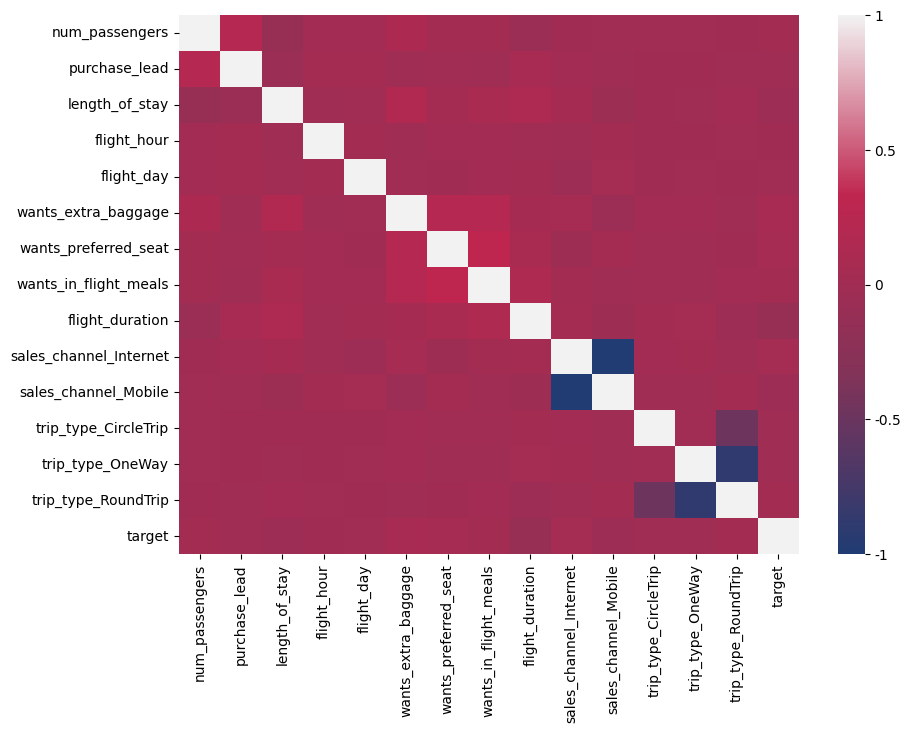

In [ ]:
# We calculate the correlation matrix
corr = scaled_df.corr()

# We create a customized color map using the company's colors.
colors = ['#203C73',"#833358", '#BF264F', '#F2F2F2']
cmap = LinearSegmentedColormap.from_list('custom', colors, N=256)
plt.figure(figsize=(10,7))
ax = sns.heatmap(corr, cmap=cmap)

# Display numerical values in the color bar
cbar = ax.collections[0].colorbar
cbar.set_ticks([-1, -0.5, 0, 0.5, 1])
cbar.set_ticklabels([-1, -0.5, 0, 0.5, 1])

plt.show()

In [ ]:
scaled_df.columns

Index(['num_passengers', 'purchase_lead', 'length_of_stay', 'flight_hour',
       'flight_day', 'wants_extra_baggage', 'wants_preferred_seat',
       'wants_in_flight_meals', 'flight_duration', 'sales_channel_Internet',
       'sales_channel_Mobile', 'trip_type_CircleTrip', 'trip_type_OneWay',
       'trip_type_RoundTrip', 'target'],
      dtype='object')

###Machine learning

In [ ]:
X = scaled_df.drop('target', axis=1)
y = scaled_df['target']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [ ]:
# We create an instance of the Random Forest model
rf = RandomForestClassifier(n_estimators=100, random_state=0)

# We train the model on the training data
rf.fit(X_train, y_train)

# We predict the class labels for the test data.
y_pred = rf.predict(X_test)

# We evaluate the performance of the model
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.4f}')

Accuracy: 0.8460


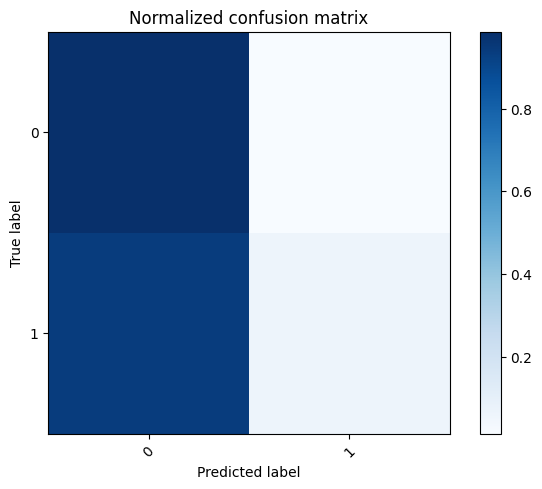

In [ ]:
# We calculate the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# We normalize the confusion matrix
cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

# We plot the confusion matrix
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Normalized confusion matrix')
plt.colorbar()
tick_marks = np.arange(2)
plt.xticks(tick_marks, [0, 1], rotation=45)
plt.yticks(tick_marks, [0, 1])
plt.tight_layout()
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [ ]:
# We obtain the importance of the characteristics
importances = rf.feature_importances_

# We create a DataFrame with the characteristics and their importance.
feature_importances = pd.DataFrame({'feature': X.columns, 'importance': importances})

# We sort the DataFrame by feature importance
feature_importances = feature_importances.sort_values('importance', ascending=True)

# We create an interactive horizontal bar chart
fig = px.bar(feature_importances, x='importance', y='feature', orientation='h', color='importance',
             color_continuous_scale=['#F299A0','#BF264F','#833358','#203C73'], title='Importance of the features')

# Show
fig.show()

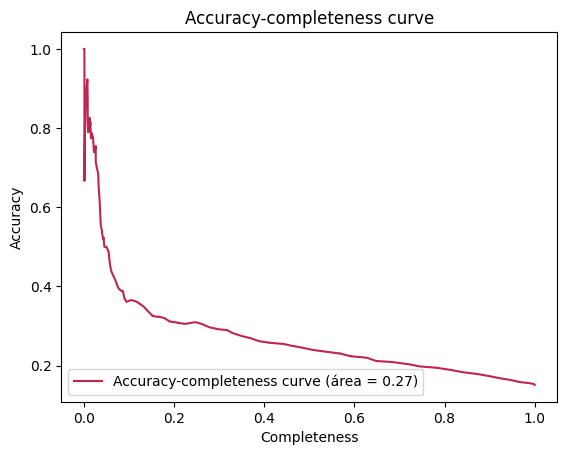

In [ ]:
# We calculate the accuracy, completeness and thresholds for the accuracy-completeness curve.
precision, recall, thresholds = precision_recall_curve(y_test, rf.predict_proba(X_test)[:, 1])

# Calculate area under the curve (AUC)
auc = auc(recall, precision)
fig, ax = plt.subplots()

# We plot the accuracy-exhaustiveness curve
ax.plot(recall, precision, label=f'Accuracy-completeness curve (área = {auc:.2f})', color='#BF264F')

# We add labels and title to the chart
ax.set_xlabel('Completeness')
ax.set_ylabel('Accuracy')
ax.set_title('Accuracy-completeness curve')
ax.legend(loc='lower left')

# Show
plt.show()

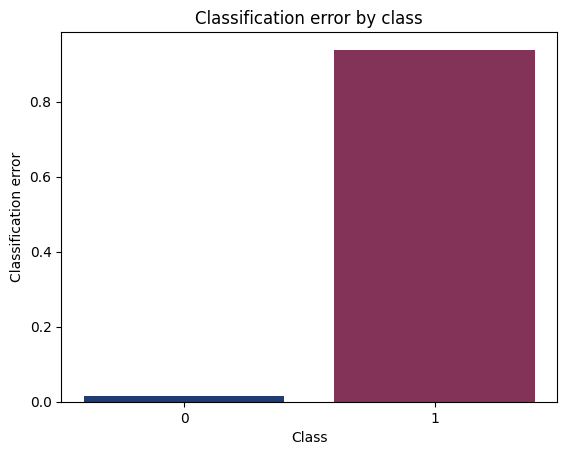

In [ ]:
# We calculate the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# We calculate the classification error by class
class_error = 1 - np.diag(cm) / np.sum(cm, axis=1)
fig, ax = plt.subplots()

# We plot the classification error by class
ax.bar(range(len(class_error)), class_error, color=['#203C73','#833358','#BF264F','#F299A0','#F2F2F2'])

# We add labels and title to the chart
ax.set_xlabel('Class')
ax.set_ylabel('Classification error')
ax.set_title('Classification error by class')
ax.set_xticks(range(len(class_error)))
ax.set_xticklabels(range(len(class_error)))

# Show
plt.show()

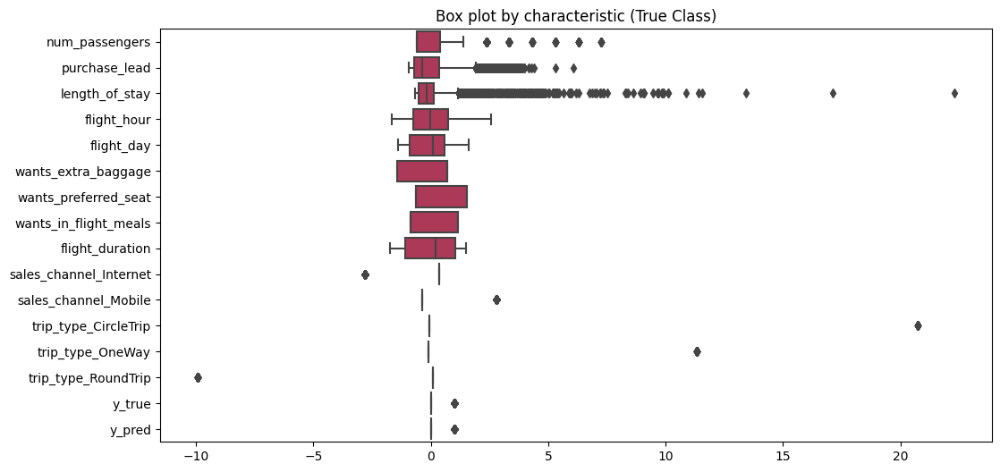

In [ ]:
# We create a copy of the test dataset with the true and predicted labels
data = X_test.copy()
data['y_true'] = y_test
data['y_pred'] = y_pred

# We create a figure for the graph
fig = plt.figure(figsize=(12, 6))

# We plot a boxplot by characteristic for each true class
ax = sns.boxplot(data=data, orient='h', color='#BF264F')
ax.set_title('Box plot by characteristic (True Class)')

# Show
plt.show()

In [ ]:
# We create an instance of the Random Forest model
rf = RandomForestClassifier(n_estimators=100, random_state=0)

# We performed a cross validation of 5 iterations
scores = cross_val_score(rf, X, y, cv=5, scoring='accuracy')

# We print the cross validation results
print(f'Scores: {scores}')
print(f'Mean score: {scores.mean():.4f}')
print(f'Standard deviation: {scores.std():.4f}')

Scores: [0.8498 0.8345 0.7747 0.3858 0.4285]
Mean score: 0.6547
Standard deviation: 0.2041


In [ ]:
# Create an instance of the Random Forest model
rf = RandomForestClassifier(n_estimators=100, random_state=0)

# Train the model on your training data
rf.fit(X_train, y_train)

RandomForestClassifier(random_state=0)

In [ ]:
# Get one of the decision trees from the trained Random Forest model
tree = rf.estimators_[0]

# Export the decision tree as a DOT file
dot_data = export_graphviz(tree, out_file=None, feature_names=X.columns, class_names=['0', '1'], filled=True, rounded=True, special_characters=True)

# Visualize the decision tree using the graphviz library
graph = graphviz.Source(dot_data)
graph

In [ ]:
goal = 'Predict whether a customer will buy a holiday'
performance_metrics = 'Accuracy: 0.8460'
insights = 'The most important features for predicting whether a customer will buy a holiday are the number of passengers and the purchase lead time.'

conclusion = f'In this analysis, we used a Random Forest model to {goal}. The model achieved a performance of {performance_metrics}. From analyzing the results, we found that {insights}'

print(conclusion)

In this analysis, we used a Random Forest model to Predict whether a customer will buy a holiday. The model achieved a performance of Accuracy: 0.8460. From analyzing the results, we found that The most important features for predicting whether a customer will buy a holiday are the number of passengers and the purchase lead time.
